<a href="https://colab.research.google.com/github/quang-vo-ds/banana_leaf_disease_detection/blob/main/banana_leaf_disease_EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Initial Setup

In [1]:
import os
import gc
import glob
import pickle
import numpy as np
import pandas as pd
import csv
from tabulate import tabulate
import pprint

# Visuals and CV2
import seaborn as sns
import matplotlib.pyplot as plt
import cv2
from PIL import Image

# Progress bar
from tqdm.notebook import tqdm
tqdm.pandas()

# Model
from torchvision import models, transforms
import torch
from sklearn.cluster import KMeans

In [2]:
# Check what device to use
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

cpu


In [3]:
from google.colab import drive
drive.mount('/content/drive')
%cd /content/drive/MyDrive/Vin_ML_Course/Final_Project
root_dir = os.getcwd()
save_dir = os.path.join(root_dir, "output/processed_data")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
/content/drive/MyDrive/Vin_ML_Course/Final_Project


In [4]:
csv_data = pd.read_csv(os.path.join(save_dir, "csv_data.csv"), index_col=False)

with open(os.path.join(save_dir, "class_int_to_name.pkl"), 'rb') as f:
    class_int_to_name = pickle.load(f)

with open(os.path.join(save_dir, "class_name_to_int.pkl"), 'rb') as f:
    class_name_to_int = pickle.load(f)

csv_data.head()

,id,label,label_name,path
0,Banana___Healthy_29.jpg,0,Healthy,/content/drive/MyDrive/Vin_ML_Course/Final_Pro...
1,Banana___Healthy_295.jpg,0,Healthy,/content/drive/MyDrive/Vin_ML_Course/Final_Pro...
2,Banana___Healthy_72.jpg,0,Healthy,/content/drive/MyDrive/Vin_ML_Course/Final_Pro...
3,Banana___Healthy_226.jpg,0,Healthy,/content/drive/MyDrive/Vin_ML_Course/Final_Pro...
4,Banana___Healthy_141.jpg,0,Healthy,/content/drive/MyDrive/Vin_ML_Course/Final_Pro...


## Utils

In [5]:
# Add feature for each image using Resnet50
model = models.resnet50(weights=models.ResNet50_Weights.DEFAULT)
model = torch.nn.Sequential(*(list(model.children())[:-1])).to(device) # Remove the last layer
model.eval()

transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225]
    )
])

def extract_features(image_id, model=model, transform=transform):
    # Free up memory after each run
    torch.cuda.empty_cache()
    gc.collect()

    try:
        # Read image
        img_dir = csv_data[csv_data["id"] == image_id]["path"].values[0]
        img = Image.open(img_dir).convert('RGB')

        # Transform image to use as torch model input
        img_t = transform(img)
        batch_t = torch.unsqueeze(img_t, 0)
    except:
        print(image_id)

    # Bring only nessary objects to GPU
    with torch.no_grad():
        batch_t = batch_t.to(device)
        features = model(batch_t)
        features = torch.squeeze(features)

    return features

if os.path.exists(os.path.join(save_dir, "resnet_features.pt")):
    resnet_features = torch.load(os.path.join(save_dir, "resnet_features.pt"), map_location=torch.device('cpu'))
    print("resnet_features is loaded")
else:
    resnet_features = []
    img_idxs_list = csv_data['id'].values.tolist()
    for i in tqdm(range(len(img_idxs_list))):
        resnet_features.append(extract_features(img_idxs_list[i]))
    resnet_features = torch.stack(resnet_features)
    torch.save(resnet_features, os.path.join(save_dir, "resnet_features.pt"))

resnet_features is loaded


In [6]:
# Plot data
def plot_images(class_id, images_number, data=csv_data, verbose=0):
    """
        Display images in a specific class
    """
    plot_idx = data[data["label"] == class_id].sample(images_number).index.tolist()
    plot_list = data.iloc[plot_idx]['id'].tolist()
    # data[data["label"] == class_id].sample(images_number)['id'].tolist()

    # Printing list of images
    if verbose:
        print(plot_list)

    labels = [data["label_name"].iloc[i] for i in plot_idx]
    size = np.sqrt(images_number)
    if int(size)*int(size) < images_number:
        size = int(size) + 1

    plt.figure(figsize=(20, 15))
    plt.style.use("dark_background")

    for ind, (image_id, label) in enumerate(zip(plot_list, labels)):
        img_dir = data[data["id"] == image_id]["path"].values[0]
        plt.subplot(size, size, ind + 1)
        image = cv2.imread(img_dir)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        plt.imshow(image)
        plt.title(label, fontsize=12)
        plt.axis("off")

    plt.show()

In [7]:
# View image cluster
def view_cluster(cluster, n_img=25, data=csv_data):
    plt.figure(figsize = (25,25));
    # gets the list of filenames for a cluster
    files = groups[cluster]
    # only allow up to 20 images to be shown at a time
    if len(files) > n_img:
        print(f"Clipping cluster size from {len(files)} to {n_img}")
        plot_idx = np.random.choice(len(files), size=n_img)
        files = np.asarray(files)[plot_idx.astype(int)].tolist()
    # plot each image in the cluster
    for index, img_idx in enumerate(files):
        plt.subplot(5,5,index+1);
        img_dir = data[data["id"] == img_idx]["path"].values[0]
        image = cv2.imread(img_dir)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        plt.imshow(image)
        plt.title(img_idx)
        plt.axis('off')

## Class distribution

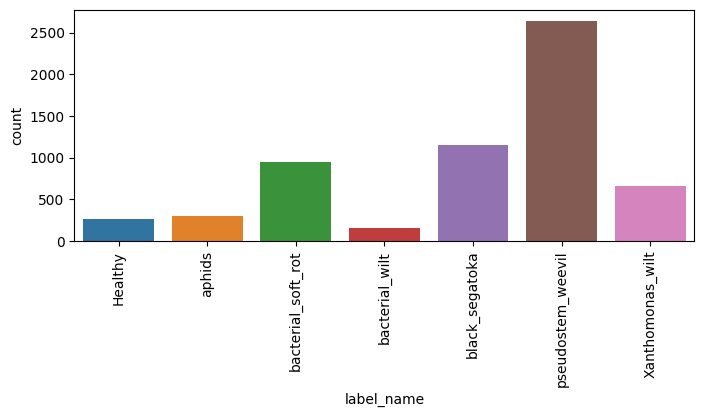

In [8]:
plt.figure(figsize=(8, 3))
sns.countplot(data=csv_data, x="label_name")
plt.xticks(rotation = 90)
plt.show()

Key take-aways:

* The dataset is highly imbalanced with just a few healthy image.
* We don't have too many images, so in this project we can pay focus on just some diseases like Pseudostem Weevil, Black Sigatoka and Bacterial Soft Rot

## Learning about each class

### Healthy

In [9]:
class_id = 0

#### Display examples

['Banana___Healthy_188.jpg', 'Banana___Healthy_160.jpg', 'Banana___Healthy_201.jpg', 'Banana___Healthy_177.jpg', 'Banana___Healthy_203.jpg', 'Banana___Healthy_153.jpg']


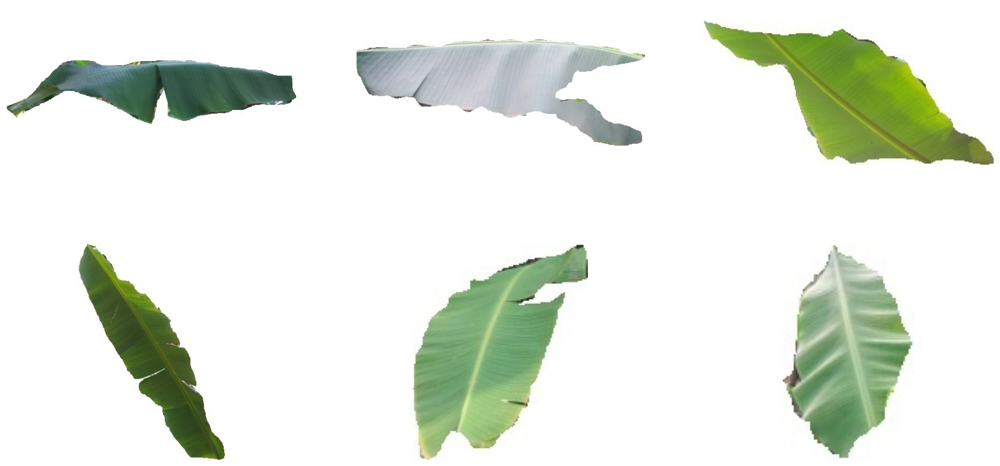

In [10]:
plot_images(class_id=class_id, images_number=6,verbose=1)

#### Cluster data

In [11]:
ids = csv_data[csv_data['label'] == class_id].index
img_ids = csv_data.iloc[ids]['id'].values
features = resnet_features[ids,:]

# Clustering
kmeans = KMeans(n_clusters=5, random_state=22)
kmeans.fit(features)

groups = {}
for img_id, cluster in zip(img_ids, kmeans.labels_):
    if cluster not in groups.keys():
        groups[cluster] = []
        groups[cluster].append(img_id)
    else:
        groups[cluster].append(img_id)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Clipping cluster size from 63 to 25


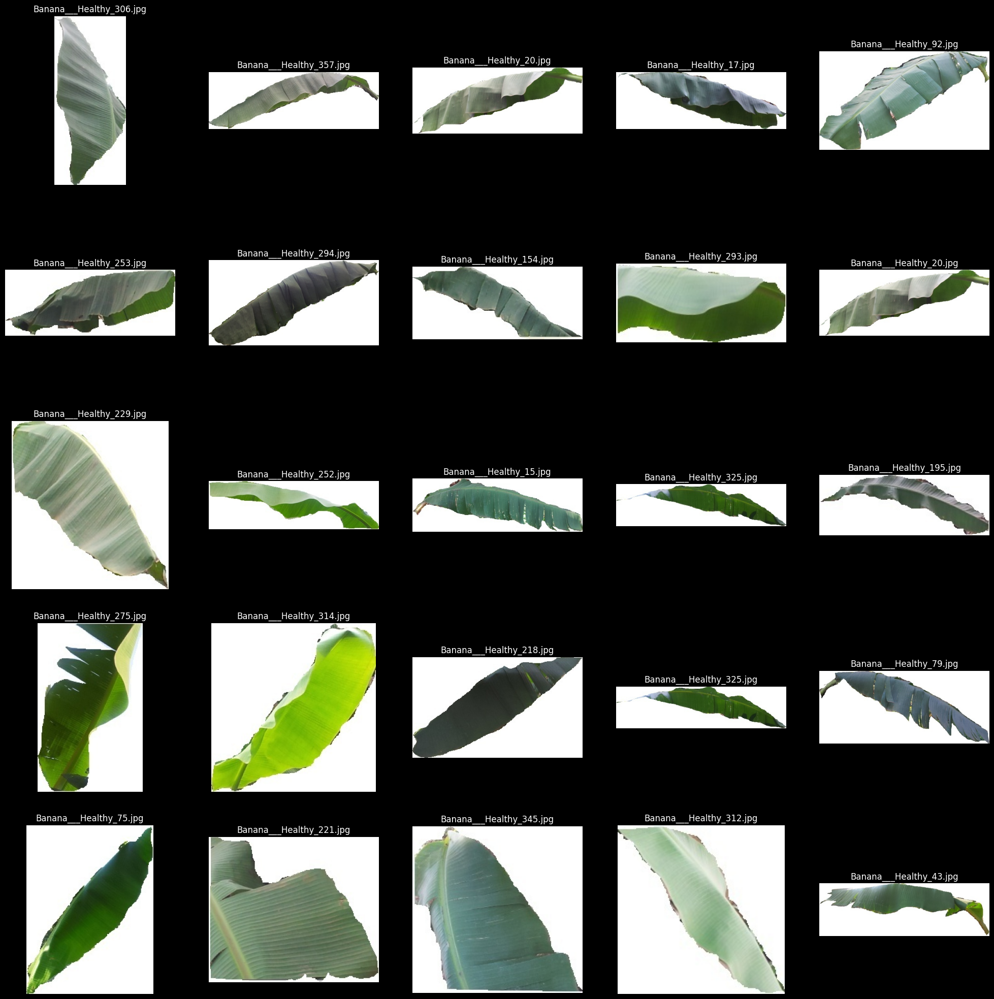

In [12]:
view_cluster(3)

Key take-aways:

* After randomly displaying the images for 5-6 times, we can see that most of the images have white backgrounds. If other diseased images don't match this style, the model may pay attention in the wrong direction when learning.
* The leaves are mostly green in color.
* No outliers

### Aphids

In [13]:
class_id = 1

#### Display examples

['BANANA_APHIDS 0001 251 .jpg', 'BANANA_APHIDS 0001 271 .jpg', 'BANANA_APHIDS 0001 81 .jpg', 'BANANA_APHIDS 0001 56 .jpg', 'BANANA_APHIDS 0001 170 .jpg', 'BANANA_APHIDS 0001 207 .jpg']


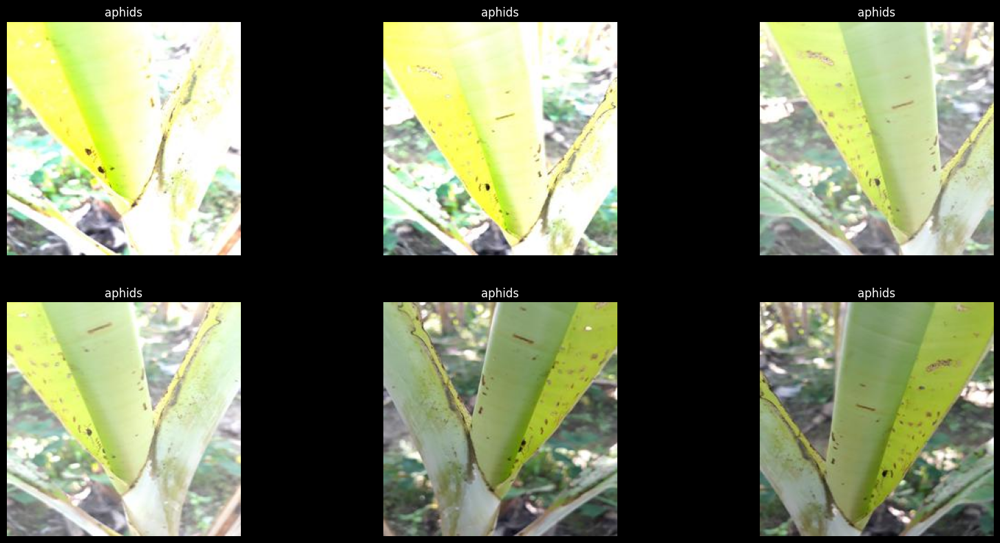

In [14]:
plot_images(class_id=class_id, images_number=6,verbose=1)

#### Cluster data

In [15]:
ids = csv_data[csv_data['label'] == class_id].index
img_ids = csv_data.iloc[ids]['id'].values
features = resnet_features[ids,:]

# Clustering
kmeans = KMeans(n_clusters=5, random_state=22)
kmeans.fit(features)

groups = {}
for img_id, cluster in zip(img_ids, kmeans.labels_):
    if cluster not in groups.keys():
        groups[cluster] = []
        groups[cluster].append(img_id)
    else:
        groups[cluster].append(img_id)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Clipping cluster size from 91 to 25


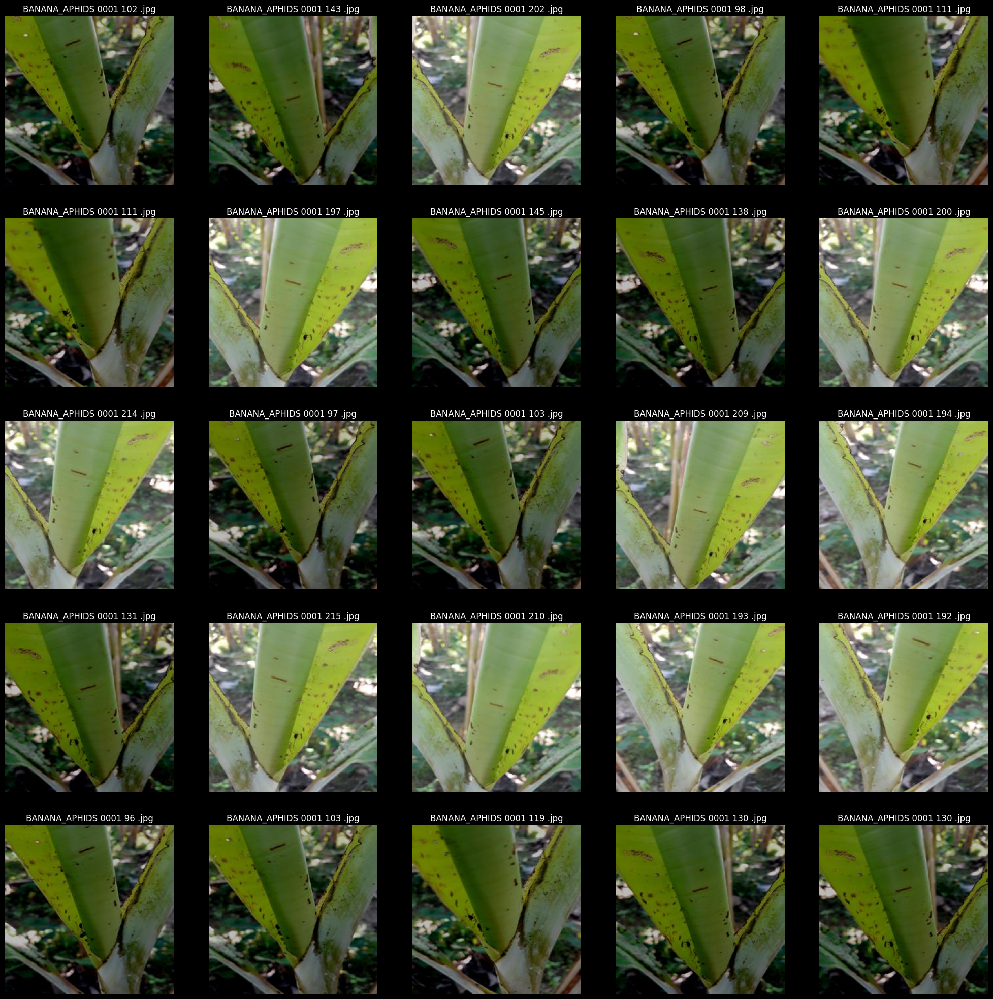

In [16]:
view_cluster(4)

Key take-aways:

* There are too many duplicated images
* The leaves have small brown spindle shaped spots
* No outliers

### Bacterial Soft Rot

In [17]:
class_id = 2

#### Display examples

['BACTERIAL_SOFT_ROT (277).jpg', 'BACTERIAL_SOFT_ROT (845).jpg', 'BACTERIAL_SOFT_ROT (496).jpg', 'BACTERIAL_SOFT_ROT (611).jpg', 'BACTERIAL_SOFT_ROT (821).jpg', 'BACTERIAL_SOFT_ROT (650).jpg']


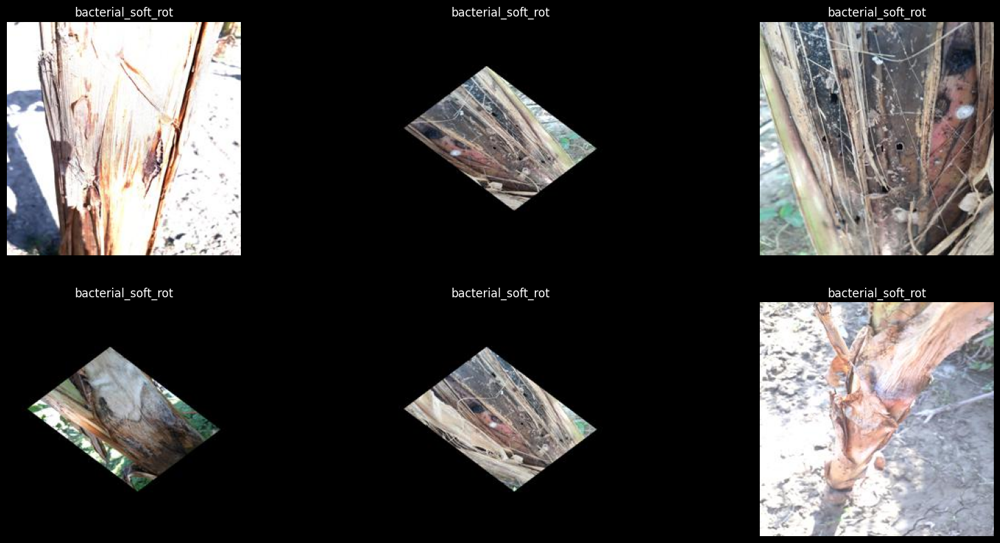

In [18]:
plot_images(class_id=class_id, images_number=6,verbose=1)

#### Cluster data

In [19]:
ids = csv_data[csv_data['label'] == class_id].index
img_ids = csv_data.iloc[ids]['id'].values
features = resnet_features[ids,:]

# Clustering
kmeans = KMeans(n_clusters=5, random_state=22)
kmeans.fit(features)

groups = {}
for img_id, cluster in zip(img_ids, kmeans.labels_):
    if cluster not in groups.keys():
        groups[cluster] = []
        groups[cluster].append(img_id)
    else:
        groups[cluster].append(img_id)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Clipping cluster size from 434 to 25


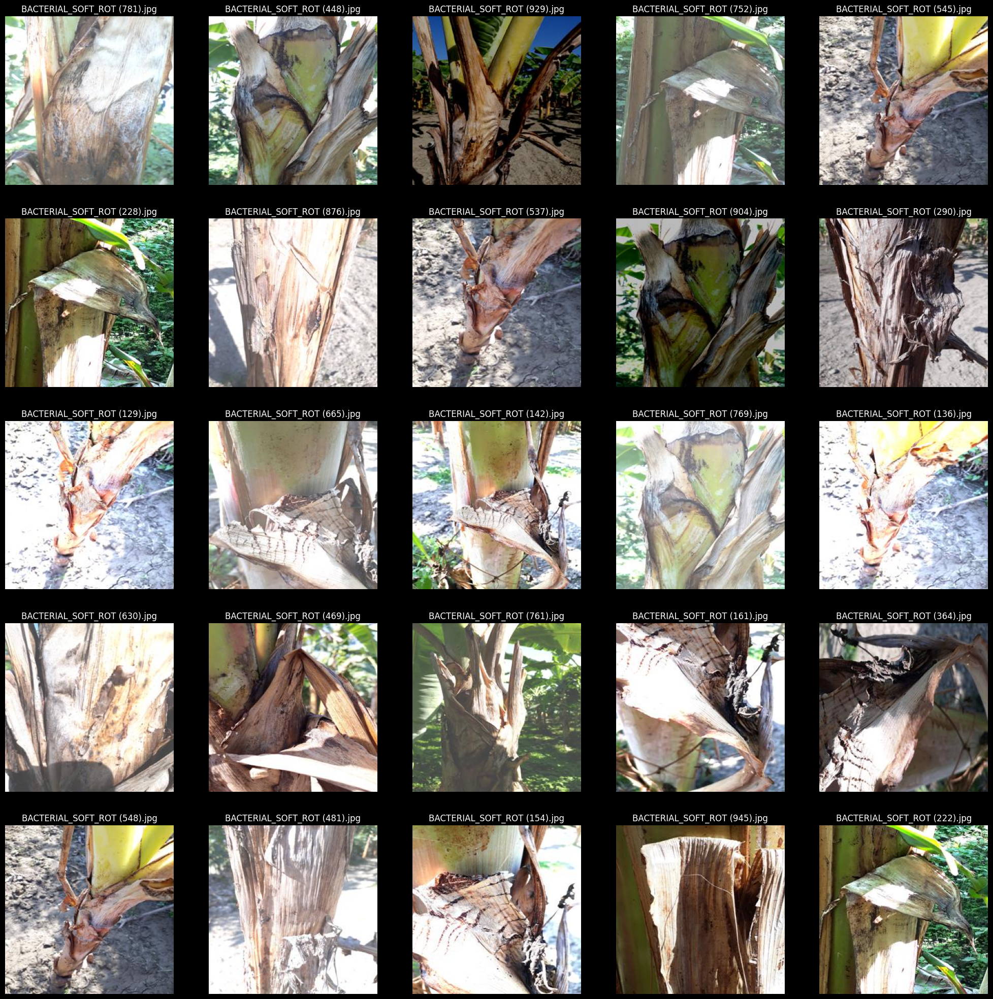

In [20]:
view_cluster(0)

Key take-aways:

* Roting of collar region

### Bacterial Wilt

In [21]:
class_id = 3

#### Display examples

['Banana___bacterial_wilt_186.jpg', 'Banana___bacterial_wilt_182.jpg', 'Banana___bacterial_wilt_101.jpg', 'Banana___bacterial_wilt_75.jpg', 'Banana___bacterial_wilt_107.jpg', 'Banana___bacterial_wilt_200.jpg']


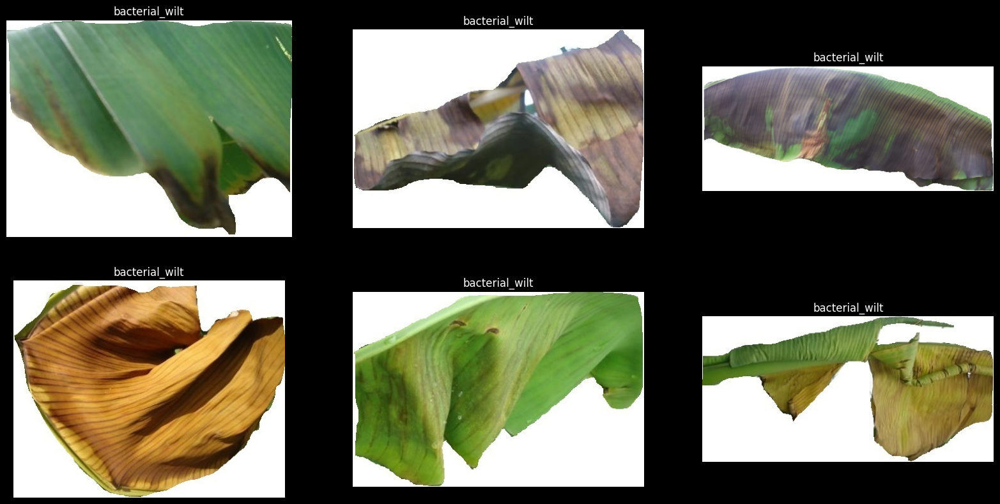

In [22]:
plot_images(class_id=class_id, images_number=6,verbose=1)

#### Cluster data

In [23]:
ids = csv_data[csv_data['label'] == class_id].index
img_ids = csv_data.iloc[ids]['id'].values
features = resnet_features[ids,:]

# Clustering
kmeans = KMeans(n_clusters=5, random_state=22)
kmeans.fit(features)

groups = {}
for img_id, cluster in zip(img_ids, kmeans.labels_):
    if cluster not in groups.keys():
        groups[cluster] = []
        groups[cluster].append(img_id)
    else:
        groups[cluster].append(img_id)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Clipping cluster size from 28 to 25


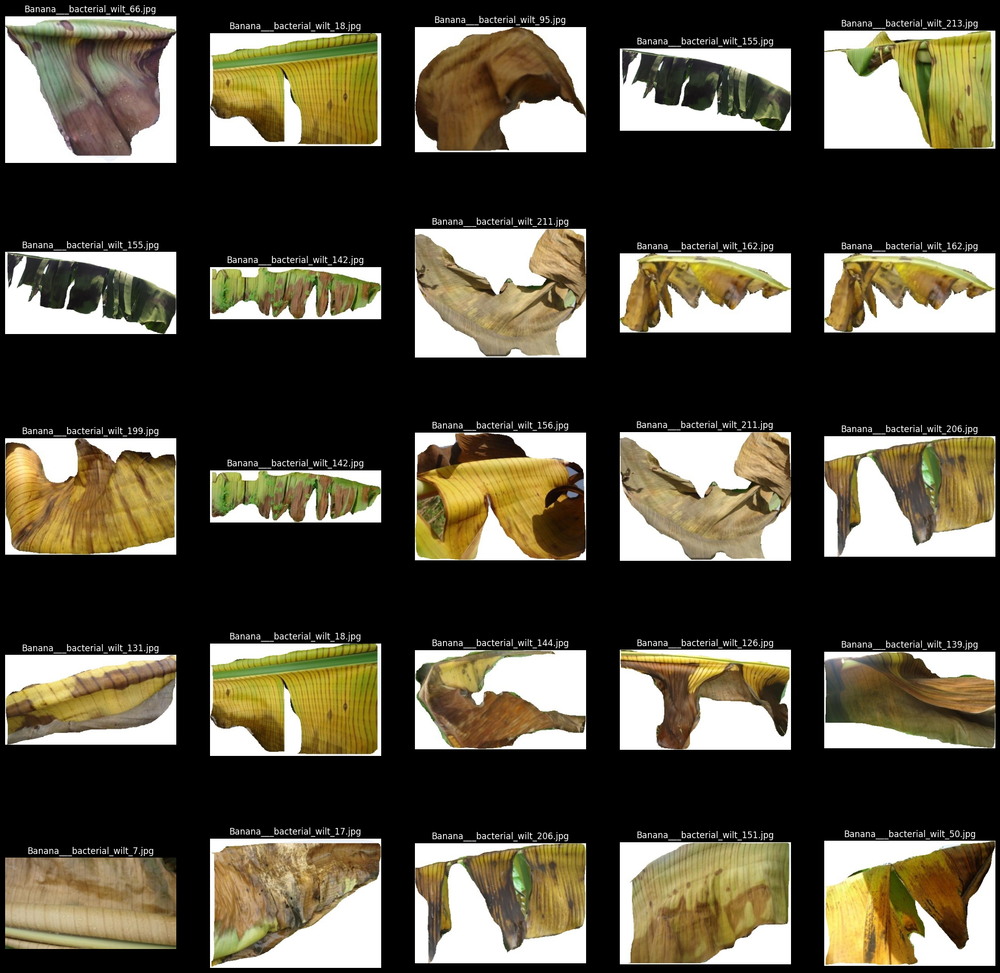

In [24]:
view_cluster(0)

Key take-aways:

* Large yellow dying area

### Black Segatoka

In [25]:
class_id = 4

#### Display examples

['Banana___black_segatoka_206.jpg', 'Banana__black_segataka_365.png', '20210219_121744.jpg', 'Banana__black_segataka_311.png', 'BLACK_SIGATOKA 0001 265 .jpg', 'BLACK_SIGATOKA 0001 60 .jpg']


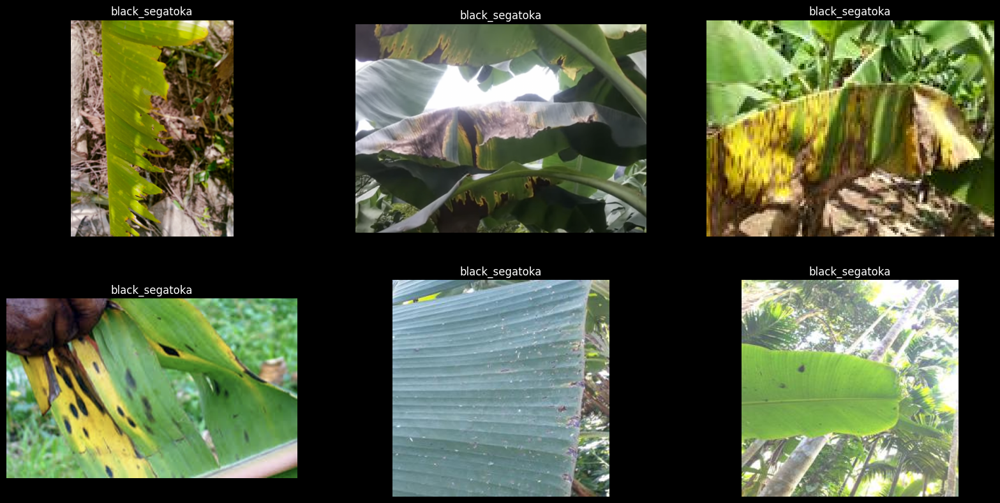

In [26]:
plot_images(class_id=class_id, images_number=6,verbose=1)

#### Cluster data

In [27]:
ids = csv_data[csv_data['label'] == class_id].index
img_ids = csv_data.iloc[ids]['id'].values
features = resnet_features[ids,:]

# Clustering
kmeans = KMeans(n_clusters=5, random_state=22)
kmeans.fit(features)

groups = {}
for img_id, cluster in zip(img_ids, kmeans.labels_):
    if cluster not in groups.keys():
        groups[cluster] = []
        groups[cluster].append(img_id)
    else:
        groups[cluster].append(img_id)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Clipping cluster size from 442 to 25


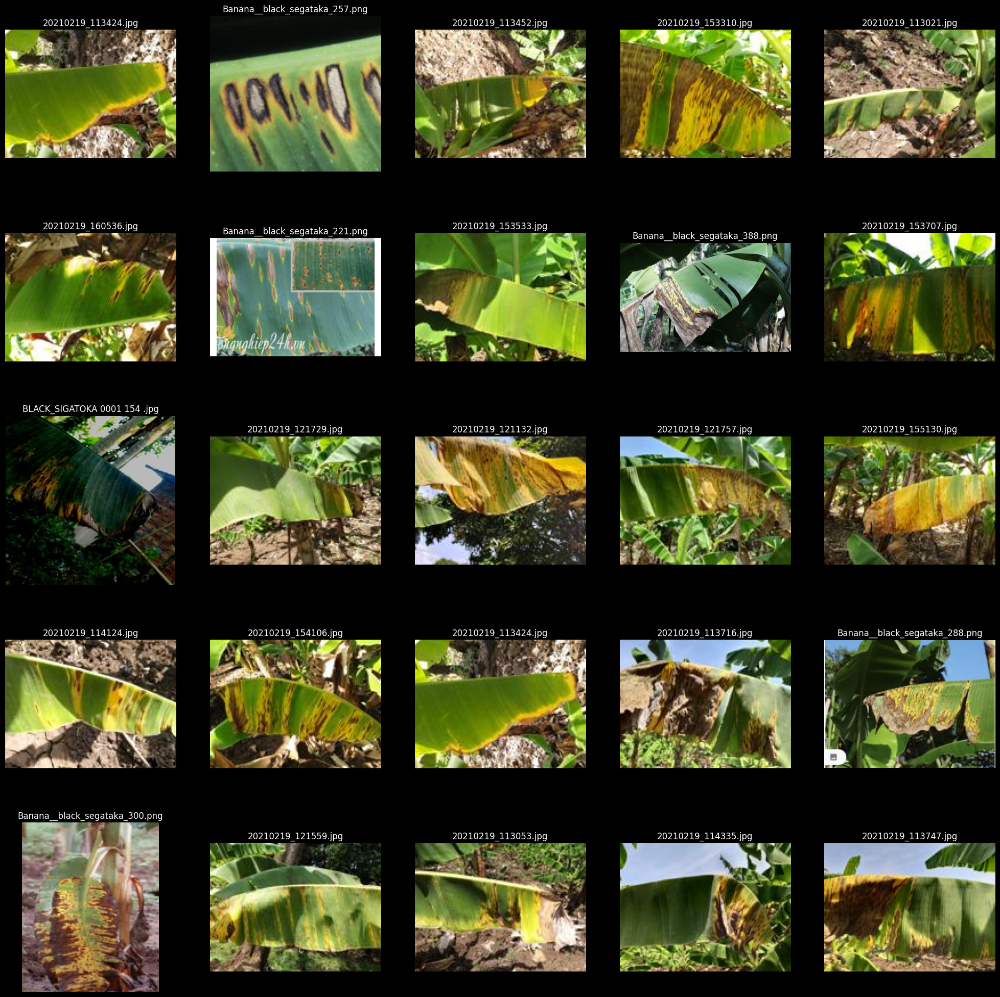

In [28]:
view_cluster(0)

Key take-aways:

*

### Pseudostem Weevil

In [37]:
class_id = 5

#### Display examples

['E 0001 229 .jpg', 'I 0001 71 .jpg', 'H 0001 270 .jpg', 'G 0001 136 .jpg', 'I 0001 23 .jpg', 'G 0001 164 .jpg']


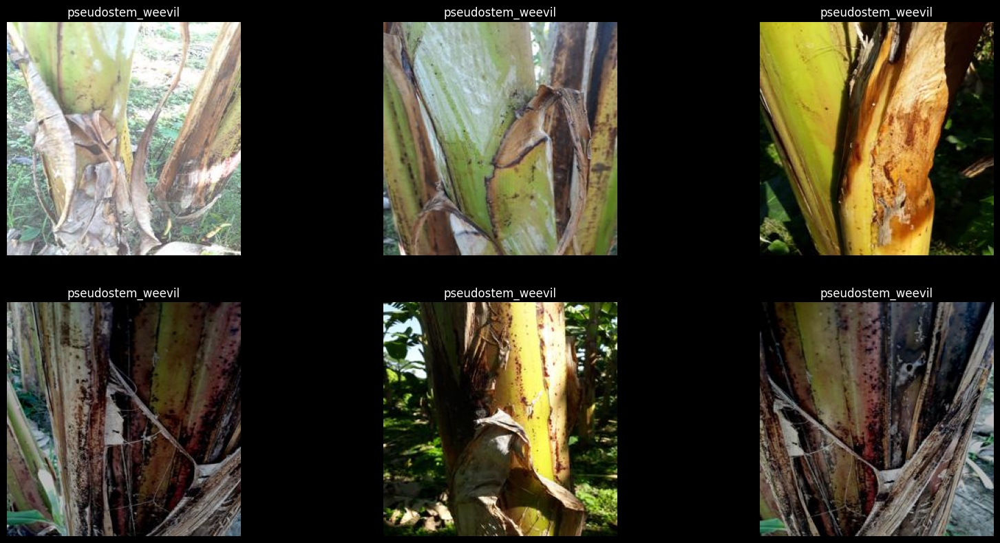

In [30]:
plot_images(class_id=class_id, images_number=6,verbose=1)

#### Cluster data

In [38]:
ids = csv_data[csv_data['label'] == class_id].index
img_ids = csv_data.iloc[ids]['id'].values
features = resnet_features[ids,:]

# Clustering
kmeans = KMeans(n_clusters=5, random_state=22)
kmeans.fit(features)

groups = {}
for img_id, cluster in zip(img_ids, kmeans.labels_):
    if cluster not in groups.keys():
        groups[cluster] = []
        groups[cluster].append(img_id)
    else:
        groups[cluster].append(img_id)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Clipping cluster size from 365 to 25


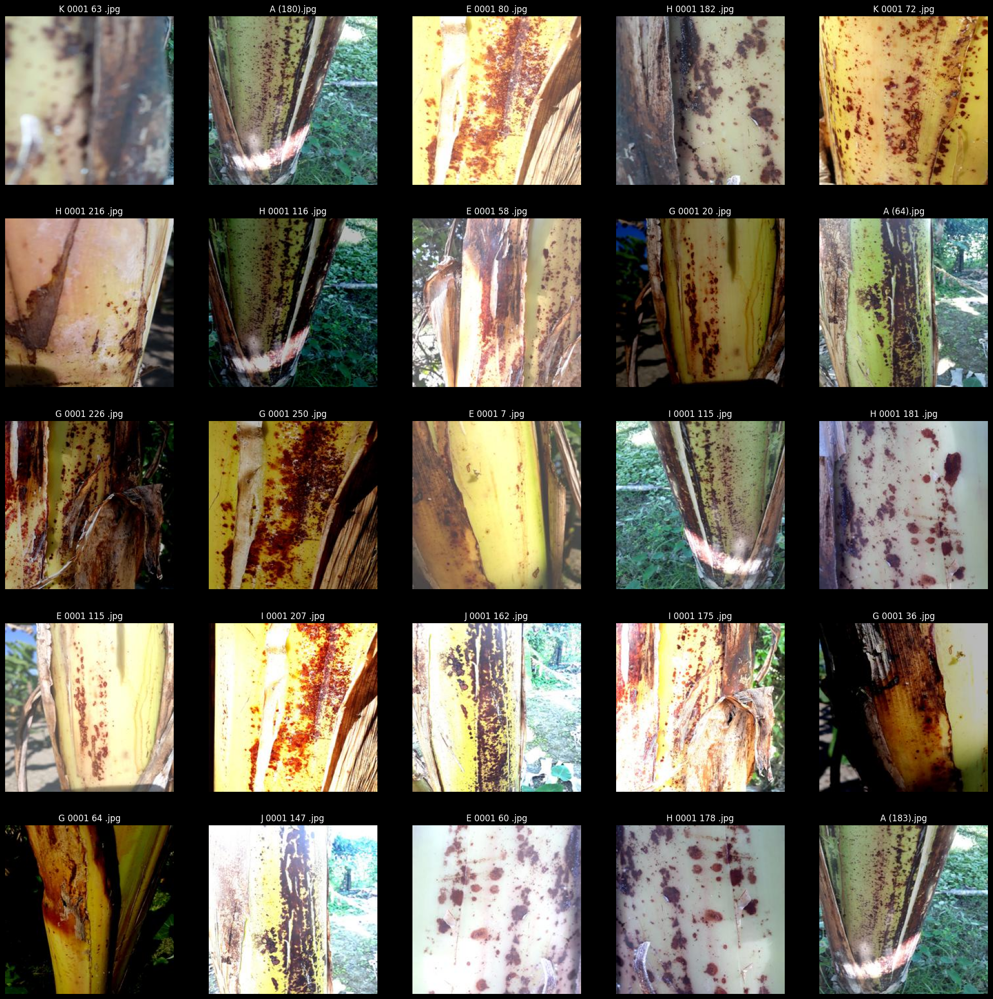

In [39]:
view_cluster(1)

Key take-aways:

*

### Xanthomonas Wilt

In [40]:
class_id = 6

#### Display examples

['20210220_105918.jpg', '20210219_154321.jpg', '20210219_150404.jpg', '20210219_145743.jpg', '20210219_154625.jpg', '20210220_105945.jpg']


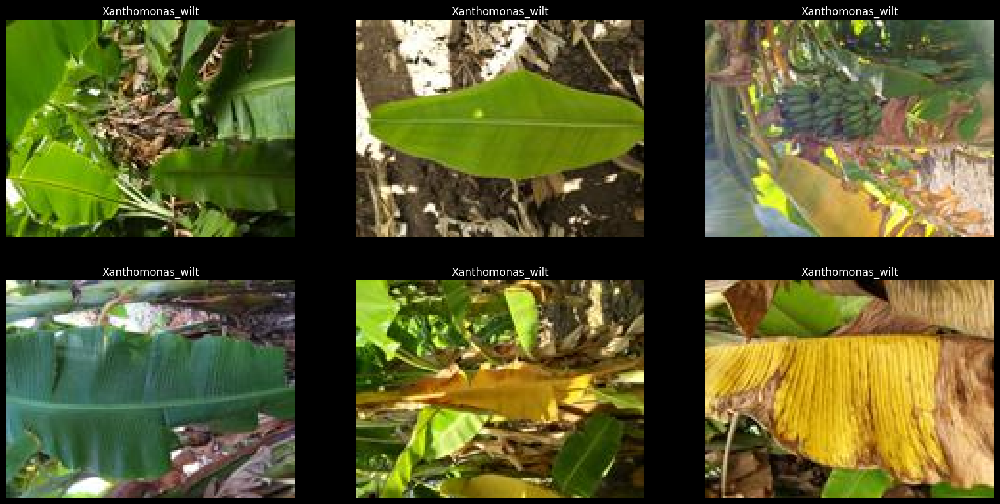

In [41]:
plot_images(class_id=class_id, images_number=6,verbose=1)

#### Cluster data

In [42]:
ids = csv_data[csv_data['label'] == class_id].index
img_ids = csv_data.iloc[ids]['id'].values
features = resnet_features[ids,:]

# Clustering
kmeans = KMeans(n_clusters=5, random_state=22)
kmeans.fit(features)

groups = {}
for img_id, cluster in zip(img_ids, kmeans.labels_):
    if cluster not in groups.keys():
        groups[cluster] = []
        groups[cluster].append(img_id)
    else:
        groups[cluster].append(img_id)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Clipping cluster size from 99 to 25


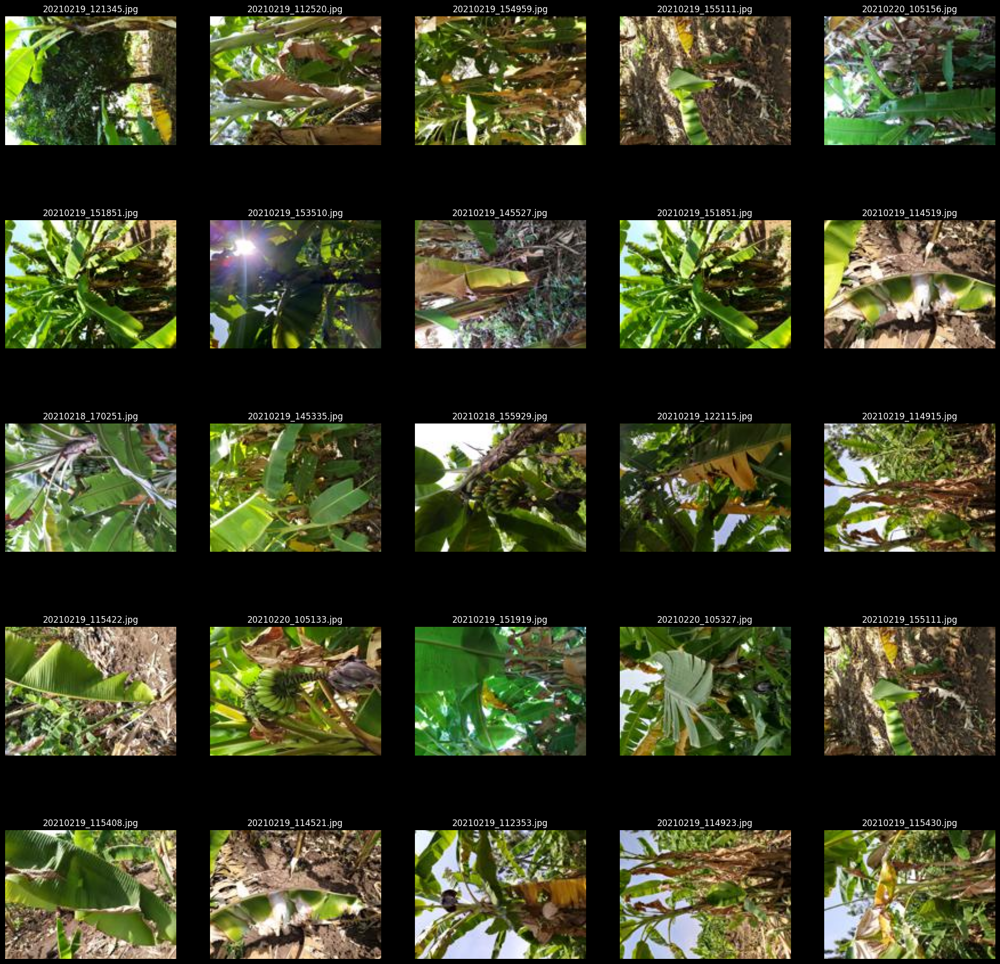

In [43]:
view_cluster(0)

Key take-aways:

*